In [18]:
import requests
import torch
from transformers import pipeline
from transformers import AutoProcessor, AutoModelForCausalLM 
# optimize with fp16 loading
model = AutoModelForCausalLM.from_pretrained("HuggingFaceM4/Florence-2-DocVQA", trust_remote_code=True, torch_dtype=torch.float16).to(torch.cuda.current_device())
processor = AutoProcessor.from_pretrained("HuggingFaceM4/Florence-2-DocVQA", trust_remote_code=True)
# model = AutoModelForCausalLM.from_pretrained("microsoft/Florence-2-large-ft", trust_remote_code=True, torch_dtype=torch.float16).to(torch.cuda.current_device())
# processor = AutoProcessor.from_pretrained("microsoft/Florence-2-large-ft", trust_remote_code=True)


A new version of the following files was downloaded from https://huggingface.co/HuggingFaceM4/Florence-2-DocVQA:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
A new version of the following files was downloaded from https://huggingface.co/HuggingFaceM4/Florence-2-DocVQA:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


In [3]:
from PIL import Image, ImageDraw, ImageFont 
import random

import numpy as np

def run_florence_2(image, task_prompt, text_input=None):
    if text_input is None:
        prompt = task_prompt
    else:
        prompt = task_prompt + text_input
    inputs = processor(text=prompt, images=image, return_tensors="pt").to(torch.cuda.current_device(), dtype=torch.float16)
    generated_ids = model.generate(
      input_ids=inputs["input_ids"],
      pixel_values=inputs["pixel_values"],
      max_new_tokens=1024,
      num_beams=1
    )
    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=False)[0]

    parsed_answer = processor.post_process_generation(generated_text, task=task_prompt, image_size=(image.width, image.height))
    return parsed_answer


def run_vqa(image, question):
    return run_florence_2(image, question, '<VQA>').get('<VQA>')
    
colormap = ['blue','orange','green','purple','brown','pink','gray','olive','cyan','red',
            'lime','indigo','violet','aqua','magenta','coral','gold','tan','skyblue']

def draw_ocr_bboxes(image, prediction, scale=1):
    draw = ImageDraw.Draw(image)
    bboxes, labels = prediction['quad_boxes'], prediction['labels']
    for box, label in zip(bboxes, labels):
        color = random.choice(colormap)
        new_box = (np.array(box) * scale).tolist()
        draw.polygon(new_box, width=3, outline=color)
        draw.text((new_box[0]+8, new_box[1]+2),
                    "{}".format(label),
                    align="right",
        
                    fill=color)
       
    display(image)

/home/erwan/anaconda3/envs/hackathon-genai/lib/python3.11/site-packages/transformers/generation/configuration_utils.py:676: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


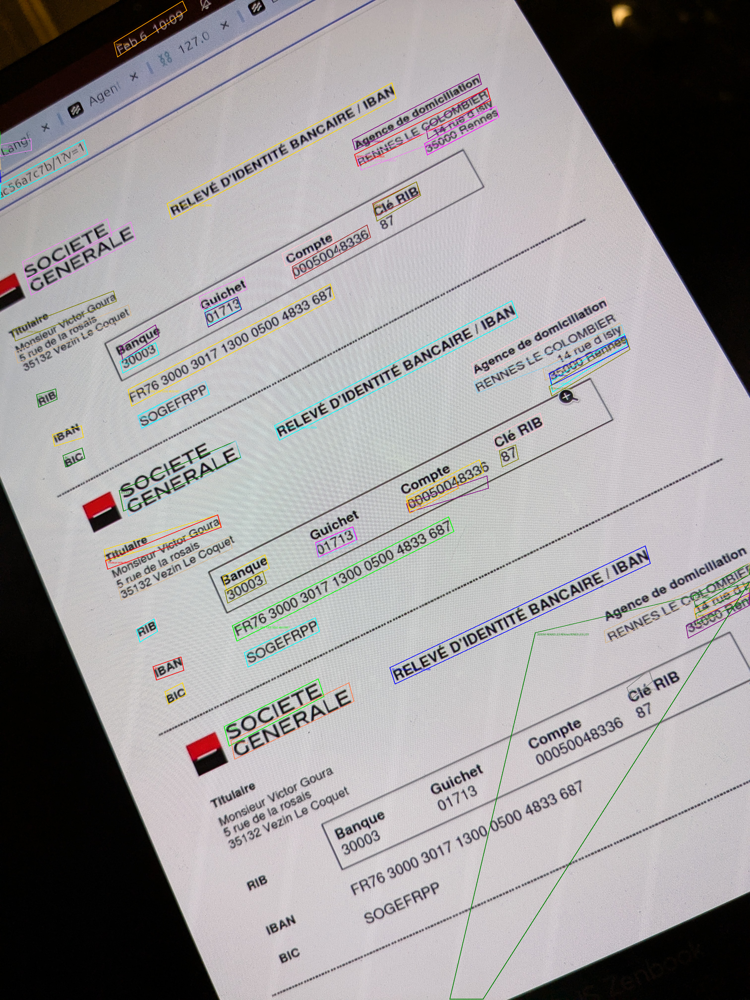

In [4]:
from PIL import Image
image = Image.open('./data/iban_rotated.jpg')
pred = run_florence_2(image, "<OCR_WITH_REGION>", text_input="").get('<OCR_WITH_REGION>')
image_bbox = draw_ocr_bboxes(image, pred)


In [17]:
labels= pred['labels']
text = "".join([label.strip().replace(' ', '') for label in labels])
import re
pattern = re.compile("^[A-Z]{2}\d{2}(?:\d{4}){3}\d{4}(?:\d\d?)?$")
pattern.match(text)

"</s>Lang/Feb610:09Lang/xx6.56a67/c7/1/v1s1SOCIETEGENERALERELIEVED'IDENTITEBANCAIRE/IBANAgencededomicillisation14.00BOMBERRENNESLECOLOMBIER13.00VezinLeCouquetCi6RIBMonstreurVictorGouraGulcheteCièsqueCiéRIB01733500504833635005438336350006383637BAN13.03001713RENNEESLERENNESRENNESSRIBFR76300020171300130000504833687BANBICSOGEFRFPSOGERRPRPSOCIEETEGENERRALERELEVEDIDENTITEBARCAIRE/IBANAGencedeDOMICILLATION14.50rubleslisysRENNESSLERennes14.20rublesLisyTitulaleurVictorGirouraTituleurvictorGourraCiÉRIB3500483363500463361713BANBAN13.02VeziniLeCoupeur13.0173171335006433363735000RennesRENnesLERennesRIBFR763000201713011300130000504933667BICSOGEEFRPPBICSOCIERTEGENERERALERELEVÉD'identITEBANCAIRE/IBN14.05BOMBIE14.0BAN14.10rublesRENNSLECOLUMBIER15.00RENNEISLECOLombIER35000483637350056RENNSLESRENnesRENESLESLISY<loc_614></poly>CieRIB"